In [ ]:
pip install torchsummary

In [10]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
!unzip '/content/drive/MyDrive/selfie2anime.zip' -d '/content/drive/MyDrive/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26059.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26076.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26092.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26125.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26139.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26145.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26149.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26157.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26167.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26181.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26190.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/trainA/female_26195.jpg  
  inflating: /content/drive/MyDrive/selfie2anime/

In [13]:
import os
import torch
import numpy as np
import torch.nn as nn
import torch.optim as optim
#from torchvision import transforms
from torchvision import datasets, transforms
from torch.autograd import Variable
from torchvision.utils import save_image
from torchvision.utils import make_grid
#from tensorboardX import SummaryWriter
from torch.utils.tensorboard import SummaryWriter
from torchsummary import summary
import datetime
import matplotlib.pyplot as plt

In [14]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [15]:
torch.manual_seed(1)

In [16]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 64
print("done")

done


In [7]:
#!unzip '/selfie2anime.zip'
#!unzip '/selfie2anime.zip'
#!unzip /selfietoanime.zip

In [17]:
train_transform = transforms.Compose([transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
train_dataset = datasets.ImageFolder(root='/content/drive/MyDrive/selfie2anime/', transform=train_transform)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)



In [18]:
def show_images(images):
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(images.detach(), nrow=22).permute(1, 2, 0))

def show_batch(dl):
    for images, _ in dl:
        show_images(images)
        break
        
print("done")

done


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


done


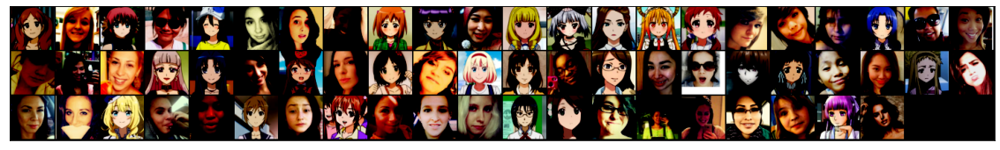

In [19]:
show_batch(train_loader)
print("done")
#show_batch(train_loader)

In [20]:
image_shape = (3, 64, 64)
image_dim = int(np.prod(image_shape))
latent_dim = 100
print("done")

done


In [21]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        torch.nn.init.normal_(m.weight, 1.0, 0.02)
        torch.nn.init.zeros_(m.bias)

In [22]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        output = self.main(input)
        return output    

In [23]:
generator = Generator().to(device)
generator.apply(weights_init)
print(generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [24]:
summary(generator, (100,1,1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

In [25]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid(),
            nn.Flatten()
        )
    def forward(self, input):
        output = self.main(input)
        return output

In [26]:
discriminator = Discriminator().to(device)
discriminator.apply(weights_init)
print(discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
    (13): Flatten(start_dim=1, end_d

In [27]:
summary(discriminator, (3,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
          Flatten-14                   

In [28]:
adversarial_loss = nn.BCELoss() 

In [29]:
def generator_loss(fake_output, label):
    gen_loss = adversarial_loss(fake_output, label)
    return gen_loss

In [30]:
def discriminator_loss(output, label):
    disc_loss = adversarial_loss(output, label)
    return disc_loss

In [31]:
fixed_noise = torch.randn(128, latent_dim, 1, 1, device=device)
real_label = 1
fake_label = 0

In [32]:
learning_rate = 0.0002 
G_optimizer = optim.Adam(generator.parameters(), lr = learning_rate, betas=(0.5, 0.999))
D_optimizer = optim.Adam(discriminator.parameters(), lr = learning_rate, betas=(0.5, 0.999))

In [33]:
!mkdir t_weights100ep
!mkdir images100ep

In [34]:
num_epochs = 100
D_loss_plot, G_loss_plot = [], []
for epoch in range(1, num_epochs+1): 

    D_loss_list, G_loss_list = [], []
   
    for index, (real_images, _) in enumerate(train_loader):
        D_optimizer.zero_grad()
        real_images = real_images.to(device)
      
        real_target = Variable(torch.ones(real_images.size(0)).to(device))
        fake_target = Variable(torch.zeros(real_images.size(0)).to(device))
        
        real_target = real_target.unsqueeze(1)
        fake_target = fake_target.unsqueeze(1)

        D_real_loss = discriminator_loss(discriminator(real_images), real_target)
        D_real_loss.backward()
    
        noise_vector = torch.randn(real_images.size(0), latent_dim, 1, 1, device=device)  
        noise_vector = noise_vector.to(device)
    
        generated_image = generator(noise_vector)
        output = discriminator(generated_image.detach())
        D_fake_loss = discriminator_loss(output,  fake_target)

        D_fake_loss.backward()
      
        D_total_loss = D_real_loss + D_fake_loss
        D_loss_list.append(D_total_loss)

        D_optimizer.step()

        
        G_optimizer.zero_grad()
        G_loss = generator_loss(discriminator(generated_image), real_target)
        G_loss_list.append(G_loss)

        G_loss.backward()
        G_optimizer.step()


    print('Epoch: [%d/%d]: D_loss: %.3f, G_loss: %.3f' % (
            (epoch), num_epochs, torch.mean(torch.FloatTensor(D_loss_list)),\
             torch.mean(torch.FloatTensor(G_loss_list))))
    
    D_loss_plot.append(torch.mean(torch.FloatTensor(D_loss_list)))
    G_loss_plot.append(torch.mean(torch.FloatTensor(G_loss_list)))
    save_image(generated_image.data[:50], './images100ep/sample_%d'%epoch + '.png', nrow=5, normalize=True)
     
    torch.save(generator.state_dict(), './t_weights100ep/generator_epoch_%d.pth' % (epoch))
    torch.save(discriminator.state_dict(), './t_weights100ep/discriminator_epoch_%d.pth' % (epoch))
    

Epoch: [1/100]: D_loss: 0.660, G_loss: 11.675
Epoch: [2/100]: D_loss: 0.633, G_loss: 6.777
Epoch: [3/100]: D_loss: 0.608, G_loss: 5.262
Epoch: [4/100]: D_loss: 0.563, G_loss: 5.201
Epoch: [5/100]: D_loss: 0.543, G_loss: 5.355
Epoch: [6/100]: D_loss: 0.517, G_loss: 4.811
Epoch: [7/100]: D_loss: 0.516, G_loss: 4.717
Epoch: [8/100]: D_loss: 0.640, G_loss: 4.779
Epoch: [9/100]: D_loss: 0.623, G_loss: 4.854
Epoch: [10/100]: D_loss: 0.569, G_loss: 4.552
Epoch: [11/100]: D_loss: 0.574, G_loss: 4.755
Epoch: [12/100]: D_loss: 0.526, G_loss: 4.829
Epoch: [13/100]: D_loss: 0.472, G_loss: 4.690
Epoch: [14/100]: D_loss: 0.519, G_loss: 4.631
Epoch: [15/100]: D_loss: 0.554, G_loss: 4.768
Epoch: [16/100]: D_loss: 0.391, G_loss: 4.583
Epoch: [17/100]: D_loss: 0.471, G_loss: 4.708
Epoch: [18/100]: D_loss: 0.590, G_loss: 4.726
Epoch: [19/100]: D_loss: 0.415, G_loss: 4.673
Epoch: [20/100]: D_loss: 0.562, G_loss: 4.446
Epoch: [21/100]: D_loss: 0.469, G_loss: 4.451
Epoch: [22/100]: D_loss: 0.413, G_loss: 4.

In [35]:
def getImagePaths(path):
    image_names = []
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            fullpath = os.path.join(dirname, filename)
            image_names.append(fullpath)
    return image_names

In [36]:
import cv2
def display_multiple_img(images_paths, rows, cols):
    figure, ax = plt.subplots(nrows=rows,ncols=cols,figsize=(500,100) )
    for ind,image_path in enumerate(images_paths):
        image=cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
        try:
            ax.ravel()[ind].imshow(image)
            ax.ravel()[ind].set_axis_off()
        except:
            continue;
    plt.tight_layout()
    plt.show()

In [ ]:
display_multiple_img(getImagePaths('./images10ep'),num_epochs//2 , 2)

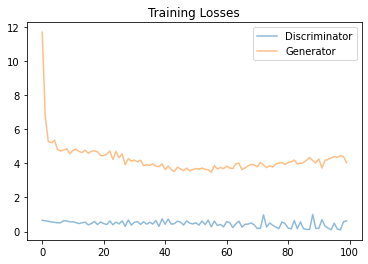

In [37]:
fig, ax = plt.subplots()
#losses = np.array(losses)
D_loss_plot=np.array(D_loss_plot)
G_loss_plot=np.array(G_loss_plot)
plt.plot(D_loss_plot, label='Discriminator', alpha=0.5)
plt.plot(G_loss_plot, label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [38]:
def view_samples(epoch, samples):
    fig, axes = plt.subplots(figsize=(16,4), nrows=2, ncols=8, sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        img = img.detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = ((img + 1)*255 / (2)).astype(np.uint8)
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        im = ax.imshow(img.reshape((32,32,3)))

In [39]:
!pip install pytorch-fid

  Created wheel for pytorch-fid: filename=pytorch_fid-0.2.1-py3-none-any.whl size=14835 sha256=45afe3280f415e41ce1cf4b0c2ba6d3134e2f20052b0ca6fecbafc832a65a121
  Stored in directory: /root/.cache/pip/wheels/24/ac/03/c5634775c8a64f702343ef5923278f8d3bb8c651debc4a6890
Successfully built pytorch-fid


In [40]:
from numpy.core.fromnumeric import prod

import torch
from torch import nn
from torchvision.models import inception_v3
import cv2
import multiprocessing
import numpy as np
import glob
import os
from scipy import linalg
from optparse import OptionParser
from torchvision import transforms
torch.cuda.empty_cache()
import scipy
def to_cuda(elements):
    """
    Transfers elements to cuda if GPU is available
    Args:
        elements: torch.tensor or torch.nn.module
        --
    Returns:
        elements: same as input on GPU memory, if available
    """
    if torch.cuda.is_available():
        return elements.cuda()
    return elements


class PartialInceptionNetwork(nn.Module):

    def __init__(self, transform_input=True):
        super().__init__()
        self.inception_network = inception_v3(pretrained=True)
        self.inception_network.Mixed_7c.register_forward_hook(self.output_hook)
        self.transform_input = transform_input

    def output_hook(self, module, input, output):
        # N x 2048 x 8 x 8
        self.mixed_7c_output = output

    def forward(self, x):
        """
        Args:
            x: shape (N, 3, 64, 64) dtype: torch.float32 in range 0-1
        Returns:
            inception activations: torch.tensor, shape: (N, 2048), dtype: torch.float32
        """
      
      
        x = x * 2 -1 
        print(x.shape)
        self.inception_network(x)

        
        activations = self.mixed_7c_output
        activations = torch.nn.functional.adaptive_avg_pool2d(activations, (1,1))
        activations = activations.view(x.shape[0], 2048)
        return activations


def get_activations_r(real_images, batch_size):
    """
    Calculates activations for last pool layer for all iamges
    --
        Images: torch.array shape: (N, 3, 64, 64), dtype: torch.float32
        batch size: batch size used for inception network
    --
    Returns: np array shape: (N, 2048), dtype: np.float32
    """
    assert real_images.shape[1:] == (3, 299, 299), "Expected input shape to be: (N,3,299,299)" +\
                                              ", but got {}".format(real_images.shape)

    num_images_r = real_images.shape[0]
    inception_network = PartialInceptionNetwork()
    inception_network = to_cuda(inception_network)
    inception_network.eval()
    r_batches = int(np.ceil(num_images_r  / batch_size))
    inception_activations_r = np.zeros((num_images_r, 2048), dtype=np.float32)
    for batch_idx in range(r_batches):
        start_idx = batch_size * batch_idx
        end_idx = batch_size * (batch_idx + 1)

        ims_r = real_images[start_idx:end_idx]
        ims_r = to_cuda(ims_r)
        activations_r = inception_network(ims_r)
        activations_r = activations_r.detach().cpu().numpy()
        inception_activations_r[start_idx:end_idx, :] = activations_r
        return inception_activations_r


def get_activations_g(generated_image, batch_size):
    """
    Calculates activations for last pool layer for all iamges
    --
        Images: torch.array shape: (N, 3, 299, 299), dtype: torch.float32
        batch size: batch size used for inception network
    --
    Returns: np array shape: (N, 2048), dtype: np.float32
    """
    
    print(generated_image.shape)
    
    num_images_g = generated_image.shape[0]
    inception_networkg = PartialInceptionNetwork()
    inception_networkg = to_cuda(inception_networkg)
    
    inception_networkg.eval()
    g_batches = int(np.ceil(num_images_g / batch_size))#batch_size
    
    inception_activationsg = np.zeros((num_images_g, 2048), dtype=np.float32)
    for batch_idx in range(g_batches):
        start_idx = batch_size * batch_idx
        end_idx = batch_size * (batch_idx + 1)

        imsg = generated_image[start_idx:end_idx]
        imsg = to_cuda(imsg)
        activationsg = inception_networkg(imsg)
        activationsg = activationsg.detach().cpu().numpy()
        
        inception_activationsg[start_idx:end_idx, :] = activationsg
    return inception_activationsg



def calculate_activation_statistics(real_images, generated_image, batch_size):
    """Calculates the statistics used by FID
    Args:
        images: torch.tensor, shape: (N, 3, H, W), dtype: torch.float32 in range 0 - 1
        batch_size: batch size to use to calculate inception scores
    Returns:
        mu:     mean over all activations from the last pool layer of the inception model
        sigma:  covariance matrix over all activations from the last pool layer 
                of the inception model.
    """
    act1 = get_activations_r(real_images, batch_size)
    mu1 = np.mean(act1, axis=0)
    sigma1 = np.cov(act1, rowvar=False)
    

    act2 = get_activations_g(generated_image, batch_size)
    mu2 = np.mean(act2, axis=0)
    sigma2 = np.cov(act2, rowvar=False)
    


    diff=mu1-mu2
    print(diff)
    diff_squared=diff.dot(diff)
    print(diff_squared)
    prod=sigma1.dot(sigma2)
    print(prod)
    sqrt_prod, _ = scipy.linalg.sqrtm(prod, disp=False)
    if np.iscomplexobj(sqrt_prod):
      sqrt_prod= sqrt_prod.real
    prod_tr=np.trace(sqrt_prod)
    final_score= diff_squared + np.trace(sigma1) + np.trace(sigma2) - 2* prod_tr
    print(final_score)

    return final_score 
    




if __name__ == "__main__":
    from optparse import OptionParser
    parser = OptionParser()
    
    
    

    p = transforms.Compose([transforms.Resize((299,299))])
    
    get_activations_g(p(generated_image), batch_size)
    get_activations_r(p(real_images), batch_size)
    calculate_activation_statistics(p(real_images), p(generated_image), batch_size)

 
    






torch.Size([24, 3, 299, 299])


Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth


  0%|          | 0.00/104M [00:00<?, ?B/s]

torch.Size([24, 3, 299, 299])
torch.Size([24, 3, 299, 299])
torch.Size([24, 3, 299, 299])
torch.Size([24, 3, 299, 299])
torch.Size([24, 3, 299, 299])
[-0.08947673 -0.10844901 -0.05352511 ... -0.01149917  0.00549215
  0.26378328]
30.574356
[[ 0.05284594 -0.11063081  0.08536892 ... -0.08885673  0.06781665
  -0.10389471]
 [-0.01284212  0.06167138 -0.06034891 ...  0.08937739 -0.01940886
   0.0784412 ]
 [ 0.03382202 -0.08982017  0.07905271 ... -0.08212681  0.05740245
  -0.08115558]
 ...
 [ 0.07186416 -0.11936935  0.10426414 ... -0.13370728  0.04131734
  -0.09960994]
 [ 0.05229467 -0.1124197   0.08463655 ... -0.12128278  0.05772307
  -0.09451136]
 [-0.10497532  0.20182077 -0.14277703 ...  0.20703631 -0.09769337
   0.18968881]]
198.39796399275315


In [42]:
import torch
torch.cuda.empty_cache()

In [38]:
torch.cuda.memory_summary(device=None, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 5            |        cudaMalloc retries: 5         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |   10806 MB |   10806 MB |    2975 GB |    2964 GB |\n|       from large pool |   10664 MB |   10664 MB |    2972 GB |    2962 GB |\n|       from small pool |     141 MB |     141 MB |       2 GB |       2 GB |\n|---------------------------------------------------------------------------|\n| Active memory         |   10806 MB |   10806 MB |    2975 GB |    2964 GB |\n|       from large pool |   10664 MB |   10664 MB |

[tensor(5.5760, grad_fn=<BinaryCrossEntropyBackward0>), tensor(6.0125, grad_fn=<BinaryCrossEntropyBackward0>)]
[tensor(0.2855, grad_fn=<AddBackward0>), tensor(0.2620, grad_fn=<AddBackward0>)]
